In [ ]:
# captioning

import os
import json
from PIL import Image
from transformers import AutoProcessor, AutoModelForCausalLM

processor = AutoProcessor.from_pretrained("microsoft/git-base")
model = AutoModelForCausalLM.from_pretrained("microsoft/git-base")

parent_dir = "../results" 

for folder_name in os.listdir(parent_dir):
    folder_path = os.path.join(parent_dir, folder_name)
    if not os.path.isdir(folder_path):
        continue 

    captions = {}

    for file_name in os.listdir(folder_path):
        if file_name.startswith("sample") and file_name.endswith(".png"):
            number = file_name.split("sample")[1].split(".png")[0]

            image_path = os.path.join(folder_path, file_name)
            image = Image.open(image_path).convert("RGB")

            inputs = processor(images=image, return_tensors="pt")
            outputs = model.generate(**inputs, max_length=50, num_beams=5)
            caption = processor.batch_decode(outputs, skip_special_tokens=True)[0]

            captions[number] = caption

    json_path = os.path.join(folder_path, f"{folder_name}_captions.json")
    with open(json_path, "w") as json_file:
        json.dump(captions, json_file, indent=4)

    print(f"Captions saved for folder: {folder_name}")


/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


Captions saved for folder: BOLD5000_CSI1_1
Captions saved for folder: GOD_sbj_3_3
Captions saved for folder: BOLD5000_CSI4_4
Captions saved for folder: GOD_sbj_1_1


In [ ]:
# average clip similarities

import os
import json
import torch
from PIL import Image
from transformers import CLIPProcessor, CLIPModel

clip_model = CLIPModel.from_pretrained("openai/clip-vit-base-patch32")
clip_processor = CLIPProcessor.from_pretrained("openai/clip-vit-base-patch32")

parent_dir = "../results" 

average_similarities = {}

for folder_name in os.listdir(parent_dir):
    folder_path = os.path.join(parent_dir, folder_name)
    if not os.path.isdir(folder_path):
        continue 

    json_path = os.path.join(folder_path, f"{folder_name}_captions.json")
    if not os.path.exists(json_path):
        print(f"Captions JSON not found for folder: {folder_name}")
        continue

    with open(json_path, "r") as json_file:
        captions = json.load(json_file)

    total_similarity = 0.0
    num_images = 0

    for number, caption in captions.items():
        gt_image_path = os.path.join(folder_path, f"gt{number}.png")
        if not os.path.exists(gt_image_path):
            print(f"GT image not found: {gt_image_path}")
            continue

        gt_image = Image.open(gt_image_path).convert("RGB")

        inputs = clip_processor(text=[caption], images=gt_image, return_tensors="pt", padding=True)
        outputs = clip_model(**inputs)

        image_embeds = outputs.image_embeds
        text_embeds = outputs.text_embeds
        similarity = torch.nn.functional.cosine_similarity(image_embeds, text_embeds, dim=-1).item()

        total_similarity += similarity
        num_images += 1

    if num_images > 0:
        average_similarity = total_similarity / num_images
    else:
        average_similarity = 0.0

    average_similarities[folder_name] = average_similarity
    print(f"Processed folder: {folder_name}, Average Similarity: {average_similarity:.4f}")

output_path = os.path.join(parent_dir, "average_similarities.json")
with open(output_path, "w") as output_file:
    json.dump(average_similarities, output_file, indent=4)

print(f"Average similarities saved to: {output_path}")

Processed folder: BOLD5000_CSI1_1, Average Similarity: 0.1927
Processed folder: GOD_sbj_3_3, Average Similarity: 0.1991
Processed folder: BOLD5000_CSI4_4, Average Similarity: 0.1872
Processed folder: GOD_sbj_1_1, Average Similarity: 0.1845
Average similarities saved to: ../results/average_similarities.json


In [ ]:
# pair-wise clip similarities

import os
import json
import torch
from PIL import Image
from transformers import CLIPProcessor, CLIPModel

clip_model = CLIPModel.from_pretrained("openai/clip-vit-base-patch32")
clip_processor = CLIPProcessor.from_pretrained("openai/clip-vit-base-patch32")

parent_dir = "../results"  

for folder_name in os.listdir(parent_dir):
    folder_path = os.path.join(parent_dir, folder_name)
    if not os.path.isdir(folder_path):
        continue 

    json_path = os.path.join(folder_path, f"{folder_name}_captions.json")
    if not os.path.exists(json_path):
        print(f"Captions JSON not found for folder: {folder_name}")
        continue

    with open(json_path, "r") as json_file:
        captions = json.load(json_file)

    similarities = {}

    for number, caption in captions.items():
        gt_image_path = os.path.join(folder_path, f"gt{number}.png")
        if not os.path.exists(gt_image_path):
            print(f"GT image not found: {gt_image_path}")
            continue

        gt_image = Image.open(gt_image_path).convert("RGB")

        inputs = clip_processor(text=[caption], images=gt_image, return_tensors="pt", padding=True)
        outputs = clip_model(**inputs)

        image_embeds = outputs.image_embeds
        text_embeds = outputs.text_embeds
        similarity = torch.nn.functional.cosine_similarity(image_embeds, text_embeds, dim=-1).item()

        similarities[number] = similarity

    captions["similarities"] = similarities
    with open(json_path, "w") as json_file:
        json.dump(captions, json_file, indent=4)

    print(f"Updated JSON file for folder: {folder_name}")


Updated JSON file for folder: BOLD5000_CSI1_1
Updated JSON file for folder: GOD_sbj_3_3
Updated JSON file for folder: BOLD5000_CSI4_4
Updated JSON file for folder: GOD_sbj_1_1


In [ ]:
# reorganizing JSON files

import os
import json

parent_dir = "../results"  

for folder_name in os.listdir(parent_dir):
    folder_path = os.path.join(parent_dir, folder_name)
    if not os.path.isdir(folder_path):
        continue  

   
    json_path = os.path.join(folder_path, f"{folder_name}_captions.json")
    if not os.path.exists(json_path):
        print(f"Captions JSON not found for folder: {folder_name}")
        continue

    with open(json_path, "r") as json_file:
        captions = json.load(json_file)


    similarities = captions.pop("similarities", {})
    updated_data = {}

    for number, caption in captions.items():
        similarity = similarities.get(number, None)
        updated_data[number] = {
            "caption": caption,
            "similarity": similarity
        }

    with open(json_path, "w") as json_file:
        json.dump(updated_data, json_file, indent=4)

    print(f"Restructured JSON file for folder: {folder_name}")


Restructured JSON file for folder: BOLD5000_CSI1_1
Restructured JSON file for folder: GOD_sbj_3_3
Restructured JSON file for folder: BOLD5000_CSI4_4
Restructured JSON file for folder: GOD_sbj_1_1



Top 5 Similarities for Folder: BOLD5000_CSI1_1


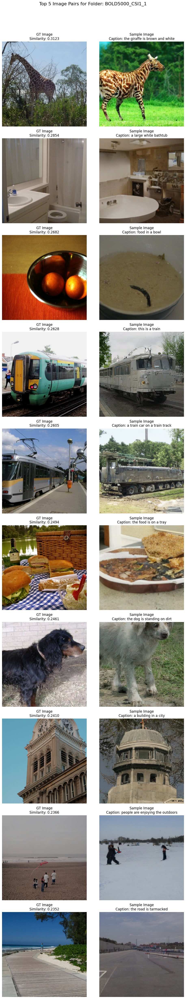


Top 5 Similarities for Folder: GOD_sbj_3_3


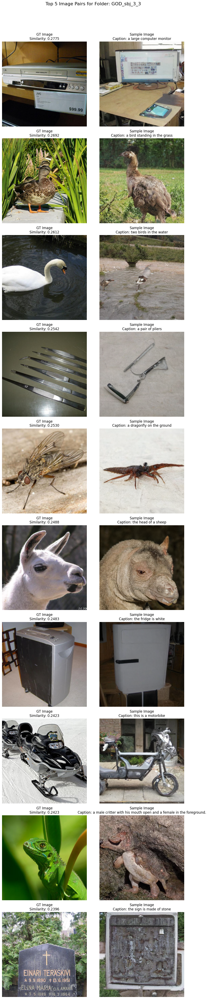


Top 5 Similarities for Folder: BOLD5000_CSI4_4


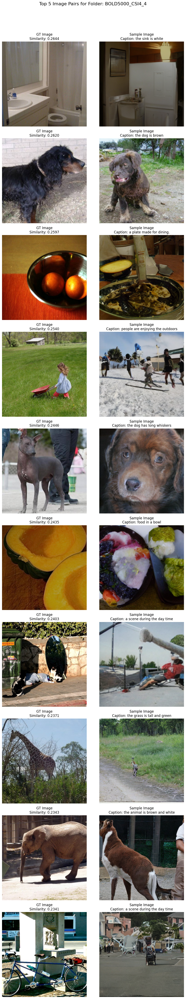


Top 5 Similarities for Folder: GOD_sbj_1_1


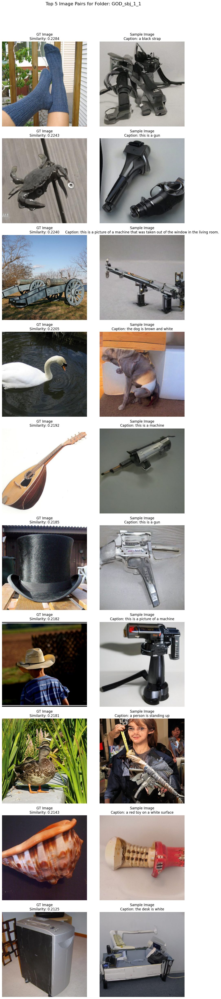

In [ ]:
# visualizing top-10 results by subject

import os
import json
import matplotlib.pyplot as plt
from PIL import Image

parent_dir = "../results"  

for folder_name in os.listdir(parent_dir):
    folder_path = os.path.join(parent_dir, folder_name)
    if not os.path.isdir(folder_path):
        continue  

    json_path = os.path.join(folder_path, f"{folder_name}_captions.json")
    if not os.path.exists(json_path):
        print(f"Captions JSON not found for folder: {folder_name}")
        continue

    with open(json_path, "r") as json_file:
        captions_data = json.load(json_file)

    pairs = []
    for number, data in captions_data.items():
        similarity = data.get("similarity", None)
        caption = data.get("caption", None)
        if similarity is not None:
            gt_image = os.path.join(folder_path, f"gt{number}.png")
            sample_image = os.path.join(folder_path, f"sample{number}.png")
            pairs.append((gt_image, sample_image, similarity, caption))

    top_pairs = sorted(pairs, key=lambda x: x[2], reverse=True)[:10]

    print(f"\nTop 5 Similarities for Folder: {folder_name}")
    fig, axes = plt.subplots(len(top_pairs), 2, figsize=(10, 5 * len(top_pairs)))
    if len(top_pairs) == 1:
        axes = [axes]  

    for i, (gt_image, sample_image, similarity, caption) in enumerate(top_pairs):
        gt_img = Image.open(gt_image)
        sample_img = Image.open(sample_image)

        axes[i][0].imshow(gt_img)
        axes[i][0].axis("off")
        axes[i][0].set_title(f"GT Image\nSimilarity: {similarity:.4f}")

        axes[i][1].imshow(sample_img)
        axes[i][1].axis("off")
        axes[i][1].set_title(f"Sample Image\nCaption: {caption}")

    plt.suptitle(f"Top 5 Image Pairs for Folder: {folder_name}", fontsize=16)
    plt.tight_layout(rect=[0, 0, 1, 0.96])
    plt.show()
